# Library import

In [ ]:
# basic libraries
import pandas as pd
import numpy as np
import cv2,os
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import warnings
warnings.filterwarnings("ignore")

# sklearn and colab libraries
from sklearn.model_selection import train_test_split,StratifiedShuffleSplit
from sklearn.metrics import accuracy_score,precision_score,recall_score,f1_score
from sklearn.metrics import hamming_loss,jaccard_similarity_score,accuracy_score,confusion_matrix
from google.colab import drive
import io,pickle

# tensorflow libraries
import tensorflow as tf
import copy  
from tensorflow.keras.regularizers import l2
# from tensorflow.keras.metrics import accuracy
import tensorflow_hub as hub
from tensorflow.keras.callbacks import Callback, ModelCheckpoint
from tensorflow.keras.layers import Input, Conv2D, ZeroPadding2D, UpSampling2D, Dense, concatenate, Conv2DTranspose,MaxPooling2D,  GlobalAveragePooling2D, MaxPooling2D
from tensorflow.keras.applications import DenseNet121
from tensorflow.keras.applications.inception_v3 import InceptionV3
from tensorflow.keras.models import load_model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.python.client import device_lib
from tensorflow.keras.layers import Layer,LeakyReLU
from tensorflow.keras.layers import Flatten, BatchNormalization, Dropout, AveragePooling2D, Activation

# sme mathmatical libraries.
from time import time
from random import random
from PIL import Image
from tqdm import tqdm_notebook
from tqdm import tqdm_notebook
import time,math,operator,datetime
import warnings
warnings.filterwarnings("ignore")
!pip install -U tensorboard_plugin_profile
import tensorboard_plugin_profile
from tensorflow.keras import backend as K

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


     |████████████████████████████████| 1.1MB 7.3MB/s 


# Flow chart of the work that is going to come

## **Flow Chat**

![alt text](https://i.imgur.com/yiUvTme.jpg)

## **Unet++ Achitecture Diagram**
![alt text](https://pythonawesome.com/content/images/2019/02/UNet.jpg)


# **Google Colab and Utility.py file Import**

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/gdrive


In [ ]:
!ls /content/gdrive/My\ Drive/CaseStudy3/UtilityModule
# !cat '/content/drive/My Drive/CaseStudy3/UtilityModule/utility.py'

__pycache__  utility.py


In [ ]:
# Code refered from Tensorboard tutorial
# https://www.tensorflow.org/tensorboard/get_started
import sys
sys.path.append('/content/gdrive/My Drive/CaseStudy3/UtilityModule/')
from utility import *

In [ ]:
# Loading the data
data = load_data()
# update the datset 
data =add_undefected_images(data)
# update the dataset
data = add_binary_label(data)
# replace NaN value in mask_pixel_sum zero.
data["mask_pixel_sum"] = data["mask_pixel_sum"].fillna(0)
# Repsent the top 5 data from dataframe.
data.head()

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).
Total train images given (7095, 3)
Binary column added....
12568
Total images from the directory : 12568
Undefected images from the directory: 5902
Final data which contain repeated imagesId tags becasue these images contain multiple type defects : 429
Suffled final data shape :  (12997, 4)


,ID,ImageId,ClassId,EncodedPixels,mask_pixel_sum,BinaryData
0,0,5e99fe1cd.jpg,0,0,0.0,0
1,1,28045eb99.jpg,0,0,0.0,0
2,2,d5425f5f5.jpg,3,123137 16 123393 46 123649 76 123905 107 12416...,10989.0,1
3,3,77fa6c315.jpg,0,0,0.0,0
4,4,b58132808.jpg,3,68 90 324 89 580 89 836 88 1092 87 1348 86 160...,90123.0,1


# Data pipeline for Multiclass Segmentation

In [18]:
# This cell is to preprocess the data to feed in data pipeline
data1 = data[data["ClassId"] != 0]
# Merging two coloums
data1["ClassId_EncodedPixels"] = data1["ClassId"].astype(str) + "," + data1["EncodedPixels"]
del data1["EncodedPixels"]
data1["EncodedPixels"] = data1["ClassId_EncodedPixels"]
del data1["ClassId_EncodedPixels"]
# Grouping the Encoded pixels on the bases of image ID anmd concating the Encoded Picels with comma
Engineered1 = data1.groupby('ImageId')['EncodedPixels'].apply(','.join).reset_index() #6666

Engineered2 = data1.ImageId.value_counts().reset_index()
# Merging teo columns
Engineered2["ImageId_Repeat"] =  Engineered2["index"] +  '_' + Engineered2["ImageId"].astype(str)
Engineered2["Repeat"] = Engineered2["ImageId"]
del Engineered2["ImageId"]
Engineered2["ImageId"] = Engineered2["index"] 
del Engineered2["index"]
# Merge two columns on the basis of ImageId
Engineered3 = pd.merge(Engineered1, Engineered2, on='ImageId')

# Below for loop will give us unique image id's with all defect 1,2,3,4 concating with comma in the Encoded pixels 
# so that in the data pipeline we can feed our models a four channel mask
list1 = []
for index in Engineered3.index:
  mask1 = ""
  mask2 = ""
  mask3 = ""
  mask4 = ""
  split_list = Engineered3["EncodedPixels"][index].split(",")
  
  if Engineered3["Repeat"][index] == 1:
    dict1 = {split_list[0]:split_list[1]}
  if Engineered3["Repeat"][index] == 2:
    dict1 = {split_list[0]:split_list[1] , split_list[2]:split_list[3]}
  if Engineered3["Repeat"][index] == 3:
    dict1 = {split_list[0]:split_list[1] , split_list[2]:split_list[3],split_list[4]:split_list[5]}  

  for key,value in dict1.items():
    if key == '1':
      mask1 =  value
    if key == '2':
      mask2 =  value
    if key == '3':
      mask3 =  value
    if key == '4':
      mask4 =  value
  if mask1 == "":
    mask1 =  "0"
  if mask2 == "":
    mask2 =  "0"
  if mask3 == "":
    mask3 =  "0"
  if mask4 == "":
    mask4 =  "0"      
  list1.append(mask1 + "," + mask2 + "," + mask3 + "," + mask4)

Engineered3["EncodedPixels_sort"] = list1

In [ ]:
train_images = "/content/gdrive/My Drive/CaseStudy3/severstal-steel-defect-detection_unzip/train_images"
Engineered3["ImageIdFiles"] = train_images+'/'+Engineered3["ImageId"]
print(Engineered3.shape)
# unet_data_class1 = unet_data_class1.applymap(str)

# Statified data as we have less number of data and we need all the class type defect in my training set in equal proportio
X_train, X_test, y_train, y_test = train_test_split(Engineered3["ImageIdFiles"][:500], Engineered3["EncodedPixels_sort"][:500], test_size=0.149,\
                                                            random_state=42)
X_train, X_cv, y_train, y_cv = train_test_split(X_train, y_train, test_size=0.2,\
                                                           random_state=42)

print(f"X_train : {X_train.shape}")
print(f"X_test : {X_test.shape}")
print(f"X_cv : {X_cv.shape}")

(6666, 6)
X_train : (340,)
X_test : (75,)
X_cv : (85,)


In [ ]:
"""
This function will take the mask and gives the decoded mask pixels and do the data augmentation for mask only for Training
"""
@tf.function
def body(mask_rle,random_number,training):
  shape = tf.convert_to_tensor((1600,256), tf.int64)
  size = tf.math.reduce_prod(shape)
  # Split string
  s = tf.strings.split(mask_rle)
  s = tf.strings.to_number(s, tf.int64)
  # Get starts and lengths
  starts = s[::2] - 1
  lens = s[1::2]
  # Make ones to be scattered
  total_ones = tf.reduce_sum(lens)
  ones = tf.ones([total_ones], tf.uint8)
  # Make scattering indices
  r = tf.range(total_ones)
  lens_cum = tf.math.cumsum(lens)
  s = tf.searchsorted(lens_cum, r, 'right')
  idx = r + tf.gather(starts - tf.pad(lens_cum[:-1], [(1, 0)]), s)
  # Scatter ones into flattened mask
  mask_flat = tf.scatter_nd(tf.expand_dims(idx, 1), ones, [size])
  # Reshape into mask
  mask  = tf.transpose(tf.reshape(mask_flat, shape)[::2,::])
  if training == True:
    mask = tf.expand_dims(mask,2)
    # Data augmentation based on randomness
    """ Mask Flipping Please check"""
    if random_number > 0.5:
      mask = tf.image.flip_left_right(mask)
    # Data augmentation based on randomness
    """ Mask Flipping Please check"""
    if random_number > 0.8:
      mask = tf.image.flip_up_down(mask)
    mask =  mask[:,:,0] 
  return mask

In [ ]:
"""Take the Filename of the image and encoded 4 channel mask and gives randomly generated augmented image and augmentated mask
eg : 256,1600 --> 256,800"""
@tf.function
def rle_decode_tf_train(filename, mask_rle):
    # Iamge Processing
    # load the raw data from the file as a string
    image = tf.io.read_file(filename)
    # convert the compressed string to a 3D uint8 tensor
    image = tf.image.decode_jpeg(image)
    random_number = tf.random.uniform(())
    if random_number > 0.5:
      image  = tf.image.adjust_brightness(image,delta=0.2)
      image = tf.image.flip_left_right(image)
    if random_number > 0.8:
      image  = tf.image.adjust_brightness(image,delta=0.2)
      image = tf.image.flip_up_down(image) 

    # Use `convert_image_dtype` to convert to floats in the [0,1] range.
    image = tf.image.convert_image_dtype(image, tf.float32)
    image = tf.image.resize(image, [256, 800])

    # Decoding of the encdoed RLE
    total_masks = tf.strings.split(mask_rle, sep=",", maxsplit=-1)

    mask_one = total_masks[0]
    mask_second = total_masks[1]
    mask_third = total_masks[2]
    mask_fourth = total_masks[3]
    zeroes = tf.zeros((256,800), dtype=tf.dtypes.uint8)
    """ Mask Flipping Please check see in body function"""
    mask_one_ = tf.cond(mask_one == '0',lambda:zeroes ,lambda: body(mask_one,random_number,True))
    mask_second_ = tf.cond(mask_second == '0',lambda:zeroes ,lambda: body(mask_second,random_number,True))
    mask_third_ = tf.cond(mask_third == '0',lambda:zeroes ,lambda: body(mask_third,random_number,True))
    mask_fourth_ = tf.cond(mask_fourth == '0',lambda:zeroes ,lambda: body(mask_fourth,random_number,True))
    final_stack = tf.stack([mask_one_,mask_second_,mask_third_,mask_fourth_], axis=2)
      
    return image,final_stack

In [ ]:
"""Take the Filename of the image and encoded 4 channel mask and gives Image and decode mask
eg : 256,1600 --> 256,800"""
@tf.function
def rle_decode_tf_test(filename, mask_rle):
    # Iamge Processing
    # load the raw data from the file as a string
    image = tf.io.read_file(filename)
    # convert the compressed string to a 3D uint8 tensor
    image = tf.image.decode_jpeg(image)
    random_number = tf.random.uniform(())

    # Use `convert_image_dtype` to convert to floats in the [0,1] range.
    image = tf.image.convert_image_dtype(image, tf.float32)
    image = tf.image.resize(image, [256, 800])

    # Decoding of the encdoed RLE
    total_masks = tf.strings.split(mask_rle, sep=",", maxsplit=-1)

    mask_one = total_masks[0]
    mask_second = total_masks[1]
    mask_third = total_masks[2]
    mask_fourth = total_masks[3]
    zeroes = tf.zeros((256,800), dtype=tf.dtypes.uint8)

    mask_one_ = tf.cond(mask_one == '0',lambda:zeroes ,lambda: body(mask_one,.2,False))
    mask_second_ = tf.cond(mask_second == '0',lambda:zeroes ,lambda: body(mask_second,.2,False))
    mask_third_ = tf.cond(mask_third == '0',lambda:zeroes ,lambda: body(mask_third,.2,False))
    mask_fourth_ = tf.cond(mask_fourth == '0',lambda:zeroes ,lambda: body(mask_fourth,.2,False))
    final_stack = tf.stack([mask_one_,mask_second_,mask_third_,mask_fourth_], axis=2)

    return image,final_stack

In [ ]:
batch= 8
batch_val = 8
global iters_train

iters_train =  X_train.shape[0]//batch
iters_test =  X_cv.shape[0]//batch

# creating the data pipeline
train_dataset = tf.data.Dataset.from_tensor_slices((X_train, y_train))
cv_dataset = tf.data.Dataset.from_tensor_slices((X_cv, y_cv))
test_dataset = tf.data.Dataset.from_tensor_slices((X_test, y_test))

train_dataset = train_dataset.cache().shuffle(X_train.shape[0],seed=batch,reshuffle_each_iteration=False).map(rle_decode_tf_train,num_parallel_calls=tf.data.experimental.AUTOTUNE).batch(batch).prefetch(tf.data.experimental.AUTOTUNE) # We are creating 16 batch as we have 256,800 pixels i want to train which need more computation Power
cv_dataset = cv_dataset.cache().map(rle_decode_tf_test,num_parallel_calls=tf.data.experimental.AUTOTUNE).batch(batch_val).prefetch(tf.data.experimental.AUTOTUNE)
test_dataset = test_dataset.cache().map(rle_decode_tf_test,num_parallel_calls=tf.data.experimental.AUTOTUNE).batch(1).prefetch(tf.data.experimental.AUTOTUNE)

# Data pipeline for Single class segmentation

In [ ]:
#@title Enter Class ID
EnterClassID =  1#@param {type:"integer"}
train_images = "/content/gdrive/My Drive/CaseStudy3/severstal-steel-defect-detection_unzip/train_images"
data1 = data[data["ClassId"] == EnterClassID]

data1["ImageIdFiles"] = train_images+'/'+data1["ImageId"]
print(data1.shape)
# unet_data_class1 = unet_data_class1.applymap(str)

# Statified data as we have less number of data and we need all the class type defect in my training set in equal proportio
X_train, X_test, y_train, y_test = train_test_split(data1["ImageIdFiles"], data1["EncodedPixels"], test_size=0.149,\
                                                            random_state=42)
X_train, X_cv, y_train, y_cv = train_test_split(X_train, y_train, test_size=0.2,\
                                                           random_state=42)

print(f"X_train : {X_train.shape}")
print(f"X_test : {X_test.shape}")
print(f"X_cv : {X_cv.shape}")

(897, 7)
X_train : (610,)
X_test : (134,)
X_cv : (153,)


In [ ]:
"""Take the Filename of the image and encoded single channel mask and gives randomly generated augmented image and augmentated mask
eg : 256,1600 --> 256,800"""
@tf.function
def rle_decode_tf_train(filename, mask_rle):
    # Iamge Processing
    # load the raw data from the file as a string
    image = tf.io.read_file(filename)
    # convert the compressed string to a 3D uint8 tensor
    image = tf.image.decode_jpeg(image)
    random_number = tf.random.uniform(())
    if random_number > 0.5:
      image  = tf.image.adjust_brightness(image,delta=0.2)
      image = tf.image.flip_left_right(image)
    if random_number > 0.8:
      image  = tf.image.adjust_brightness(image,delta=0.2)
      image = tf.image.flip_up_down(image) 

    # Use `convert_image_dtype` to convert to floats in the [0,1] range.
    image = tf.image.convert_image_dtype(image, tf.float32)
    image = tf.image.resize(image, [256, 800])

    # Decoding of the encdoed RLE
    shape = tf.convert_to_tensor((1600,256), tf.int64)
    size = tf.math.reduce_prod(shape)
    # Split string
    s = tf.strings.split(mask_rle)
    s = tf.strings.to_number(s, tf.int64)
    # Get starts and lengths
    starts = s[::2] - 1
    lens = s[1::2]
    # Make ones to be scattered
    total_ones = tf.reduce_sum(lens)
    ones = tf.ones([total_ones], tf.uint8)
    # Make scattering indices
    r = tf.range(total_ones)
    lens_cum = tf.math.cumsum(lens)
    s = tf.searchsorted(lens_cum, r, 'right')
    idx = r + tf.gather(starts - tf.pad(lens_cum[:-1], [(1, 0)]), s)
    # Scatter ones into flattened mask
    mask_flat = tf.scatter_nd(tf.expand_dims(idx, 1), ones, [size])
    # Reshape into mask
    mask  = tf.transpose(tf.reshape(mask_flat, shape)[::2,::])
    mask = tf.expand_dims(mask,2)
    """ Mask Flipping Please check"""
    if random_number > 0.5:
      mask = tf.image.flip_left_right(mask)
    if random_number > 0.8:
      mask = tf.image.flip_up_down(mask)  
    return image,mask[:,:,0]

In [ ]:
"""Take the Filename of the image and encoded single channel mask and gives image and mask"""
@tf.function
def rle_decode_tf_test(filename, mask_rle):
    # Iamge Processing
    # load the raw data from the file as a string
    image = tf.io.read_file(filename)
    # convert the compressed string to a 3D uint8 tensor
    image = tf.image.decode_jpeg(image)
    random_number = tf.random.uniform(())

    # Use `convert_image_dtype` to convert to floats in the [0,1] range.
    image = tf.image.convert_image_dtype(image, tf.float32)
    image = tf.image.resize(image, [256, 800])

    # Decoding of the encdoed RLE
    shape = tf.convert_to_tensor((1600,256), tf.int64)
    size = tf.math.reduce_prod(shape)
    # Split string
    s = tf.strings.split(mask_rle)
    s = tf.strings.to_number(s, tf.int64)
    # Get starts and lengths
    starts = s[::2] - 1
    lens = s[1::2]
    # Make ones to be scattered
    total_ones = tf.reduce_sum(lens)
    ones = tf.ones([total_ones], tf.uint8)
    # Make scattering indices
    r = tf.range(total_ones)
    lens_cum = tf.math.cumsum(lens)
    s = tf.searchsorted(lens_cum, r, 'right')
    idx = r + tf.gather(starts - tf.pad(lens_cum[:-1], [(1, 0)]), s)
    # Scatter ones into flattened mask
    mask_flat = tf.scatter_nd(tf.expand_dims(idx, 1), ones, [size])
    # Reshape into mask
    mask  = tf.transpose(tf.reshape(mask_flat, shape)[::2,::])
    return image,mask	

In [ ]:
#@title Do you want to repeat dataset?
repeat_no =  1#@param {type:"integer"}
batch= 5
batch_val = 5
global iters_train

iters_train =  (X_train.shape[0]*repeat_no)//batch
iters_test =  (X_cv.shape[0]*repeat_no)//batch

train_dataset = tf.data.Dataset.from_tensor_slices((X_train, y_train))
cv_dataset = tf.data.Dataset.from_tensor_slices((X_cv, y_cv))
test_dataset = tf.data.Dataset.from_tensor_slices((X_test, y_test))

train_dataset = train_dataset.cache().shuffle(X_train.shape[0],seed=batch,reshuffle_each_iteration=False).repeat(repeat_no).map(rle_decode_tf_train,num_parallel_calls=tf.data.experimental.AUTOTUNE).batch(batch).prefetch(tf.data.experimental.AUTOTUNE) # We are creating 16 batch as we have 256,800 pixels i want to train which need more computation Power
cv_dataset = cv_dataset.cache().map(rle_decode_tf_test,num_parallel_calls=tf.data.experimental.AUTOTUNE).batch(batch_val).prefetch(tf.data.experimental.AUTOTUNE)
test_dataset = test_dataset.cache().map(rle_decode_tf_test,num_parallel_calls=tf.data.experimental.AUTOTUNE).batch(1).prefetch(tf.data.experimental.AUTOTUNE)

# Subclass of Model and Layer of UNET++

In [ ]:
# https://github.com/CarryHJR/Nested-UNet/blob/e477bf8ef4d37e849d11e81cfbb991c7fa2f48d0/model.py#L53

# https://www.tensorflow.org/guide/keras/custom_layers_and_models#building_models


# Custom Layer
class standard_unit(Layer):

  def __init__(self, stage, nb_filter, kernel_size=3):

    super(standard_unit, self).__init__()
    self.dropout_rate = .4
    self.initializer = tf.random_normal_initializer(0., 0.02)
    self.conv1 = Conv2D(nb_filter, (kernel_size, kernel_size), name='conv'+stage+'_1', kernel_initializer = tf.keras.initializers.he_normal(5), padding='same')
    self.batchnorm = BatchNormalization()
    self.leakyrelu = LeakyReLU(alpha=0.1)
    self.dropout1 = Dropout(self.dropout_rate, name='dp'+stage+'_1')
    self.conv2 = Conv2D(nb_filter, (kernel_size, kernel_size), name='conv'+stage+'_2', kernel_initializer = tf.keras.initializers.he_normal(5) , padding='same')
    self.dropout2 = Dropout(self.dropout_rate, name='dp'+stage+'_2')
    

  @tf.function
  def call(self, input_tensor,training = None):
    # Conv2d ==> batchnorm ==>Dropout ==> LeakyRelu

    x = self.conv1(input_tensor)
    x = self.batchnorm(x)
    if training == True:
      x = self.dropout1(x)
    x = self.leakyrelu(x)  
    return x

# Custom Model
class UnetPlusPlus(tf.keras.Model):
  def __init__(self,num_class,**kwargs):
    super(UnetPlusPlus, self).__init__(**kwargs)

    # Model definations are mentioned hete in __int__

    self.backbone = tf.keras.applications.DenseNet121(input_shape=(256, 800, 3), include_top=False,weights='imagenet')
    # self.backbone =  = tf.keras.applications.MobileNetV2(input_shape=[256, 800, 3], include_top=False)
    self.conv1_1 = self.backbone.get_layer(index = 4).output
    self.conv2_1 = self.backbone.get_layer(index = 51).output 
    self.conv3_1 = self.backbone.get_layer(index = 139).output
    self.conv4_1 = self.backbone.get_layer(index = 311).output

    self.down_stack = tf.keras.Model(inputs=self.backbone.input, outputs=[self.conv1_1, self.conv2_1, self.conv3_1, self.conv4_1])
    self.down_stack.trainable = False

    self.num_class = num_class
    self.nb_filter = tf.convert_to_tensor([64,128,256,512,1024])

    self.pool4 = MaxPooling2D((2, 2))
    self.leakyrelu = LeakyReLU(alpha=0.1)

    self.standard_unit_12 = standard_unit(stage='12', nb_filter=self.nb_filter[0])
    self.standard_unit_22 = standard_unit(stage='22', nb_filter=self.nb_filter[1])
    self.standard_unit_13 = standard_unit(stage='13', nb_filter=self.nb_filter[0])
    self.standard_unit_32 = standard_unit(stage='32', nb_filter=self.nb_filter[2])
    self.standard_unit_23 = standard_unit(stage='23', nb_filter=self.nb_filter[1])
    self.standard_unit_14 = standard_unit(stage='14', nb_filter=self.nb_filter[0])
    self.standard_unit_51 = standard_unit(stage='51', nb_filter=self.nb_filter[4])

    self.standard_unit_42 = standard_unit(stage='42', nb_filter=self.nb_filter[3])
    self.standard_unit_33 = standard_unit(stage='33', nb_filter=self.nb_filter[2])
    self.standard_unit_24 = standard_unit(stage='24', nb_filter=self.nb_filter[1])
    self.standard_unit_15 = standard_unit(stage='15', nb_filter=self.nb_filter[0])

    self.standard_unit_02 = standard_unit(stage='02', nb_filter=32)
    self.standard_unit_03 = standard_unit(stage='03', nb_filter=32)
    self.standard_unit_04 = standard_unit(stage='04', nb_filter=32)
    self.standard_unit_05 = standard_unit(stage='05', nb_filter=32)

    self.up1_2 = Conv2DTranspose(self.nb_filter[0], (2, 2), strides=(2, 2), name='up12', padding='same')

    self.up2_2 = Conv2DTranspose(self.nb_filter[1], (2, 2), strides=(2, 2), name='up22', padding='same')

    self.up1_3 = Conv2DTranspose(self.nb_filter[0], (2, 2), strides=(2, 2), name='up13', padding='same')

    self.up3_2 = Conv2DTranspose(self.nb_filter[2], (2, 2), strides=(2, 2), name='up32', padding='same')

    self.up2_3 = Conv2DTranspose(self.nb_filter[1], (2, 2), strides=(2, 2), name='up13', padding='same')

    self.up1_4 = Conv2DTranspose(self.nb_filter[0], (2, 2), strides=(2, 2), name='up14', padding='same')

    self.up4_2 = Conv2DTranspose(self.nb_filter[3], (2, 2), strides=(2, 2), name='up42', padding='same')

    self.up3_3 = Conv2DTranspose(self.nb_filter[2], (2, 2), strides=(2, 2), name='up33', padding='same')

    self.up2_4 = Conv2DTranspose(self.nb_filter[1], (2, 2), strides=(2, 2), name='up24', padding='same')

    self.up1_5 = Conv2DTranspose(self.nb_filter[0], (2, 2), strides=(2, 2), name='up15', padding='same')

    self.conv0_2 = Conv2DTranspose(32, (2, 2), strides=(2, 2), name='Trans02', padding='same')
    self.nestnet_output_1 = Conv2D(self.num_class, (1, 1), activation='sigmoid', name='output_1', kernel_initializer = 'he_normal', padding='same')

    self.conv0_3 = Conv2DTranspose(32, (2, 2), strides=(2, 2), name='Trans03', padding='same')
    self.nestnet_output_2 =Conv2D(self.num_class, (1, 1), activation='sigmoid', name='output_2', kernel_initializer = 'he_normal', padding='same')

    self.conv0_4 = Conv2DTranspose(32, (2, 2), strides=(2, 2), name='Trans04', padding='same')
    self.nestnet_output_3 = Conv2D(self.num_class, (1, 1), activation='sigmoid', name='output_3', kernel_initializer = 'he_normal', padding='same')

    self.conv0_5 = Conv2DTranspose(32, (2, 2), strides=(2, 2), name='Trans05', padding='same')
    self.nestnet_output_4 = Conv2D(self.num_class, (1, 1), activation='sigmoid', name='output_4', kernel_initializer = 'he_normal', padding='same')

#https://www.tensorflow.org/guide/function
  @tf.function
  def call(self, input_image,training=None):
    # Model Structure
    skips = self.down_stack(input_image)

    up1_2 = self.up1_2(skips[1])
    conv1_2 = concatenate([up1_2 , skips[0]], name='merge12', axis=3)
    conv1_2 = self.standard_unit_12(conv1_2,training)

    up2_2 = self.up2_2(skips[2])
    conv2_2 = concatenate([up2_2 , skips[1]], name='merge22', axis=3)
    conv2_2 = self.standard_unit_22(conv2_2,training)

    up1_3 = self.up1_3(conv2_2)
    conv1_3 = concatenate([up1_3 , skips[0],  conv1_2], name='merge13', axis=3)
    conv1_3 = self.standard_unit_13(conv1_3,training)

    up3_2 = self.up3_2(skips[3])
    conv3_2 = concatenate([up3_2 , skips[2]], name='merge32', axis=3)
    conv3_2 = self.standard_unit_32(conv3_2,training)

    up2_3 = self.up2_3(conv3_2)
    conv2_3 = concatenate([up2_3 , skips[1],  conv2_2], name='merge23', axis=3)
    conv2_3 = self.standard_unit_23(conv2_3,training)

    up1_4 = self.up1_4(conv2_3)
    conv1_4 = concatenate([up1_4 , skips[0], conv1_2, conv1_3], name='merge14', axis=3)
    conv1_4 = self.standard_unit_14(conv1_4,training)

    leakyrelu = self.leakyrelu(skips[3])
    pool4 = self.pool4(leakyrelu)
    conv5_1 = self.standard_unit_51(pool4,training)


    up4_2 = self.up4_2(conv5_1)
    conv4_2 = concatenate([up4_2 , skips[3]], name='merge42', axis=3)
    conv4_2 = self.standard_unit_42(conv4_2,training)

    up3_3 = self.up3_3(conv4_2)
    conv3_3 = concatenate([up3_3 , skips[2], conv3_2], name='merge33', axis=3)
    conv3_3 = self.standard_unit_33(conv3_3,training)

    up2_4 = self.up2_4(conv3_3)
    conv2_4 = concatenate([up2_4 , skips[1], conv2_2, conv2_3], name='merge24', axis=3)
    conv2_4 = self.standard_unit_24(conv2_4)

    up1_5 = self.up1_5(conv2_4)
    conv1_5 = concatenate([up1_5 , skips[0], conv1_2, conv1_3, conv1_4], name='merge15', axis=3)
    conv1_5 = self.standard_unit_15(conv1_5,training)

    """ Output """
    conv0_2 = self.conv0_2(conv1_2)
    conv0_2 = self.standard_unit_02(conv0_2,training)
    nestnet_output_1 = self.nestnet_output_1(conv0_2)

    conv0_3 = self.conv0_3(conv1_3)
    conv0_3 = self.standard_unit_03(conv0_3,training)
    nestnet_output_2 = self.nestnet_output_2(conv0_3)

    conv0_4 = self.conv0_4(conv1_4)
    conv0_4 = self.standard_unit_04(conv0_4,training)
    nestnet_output_3 = self.nestnet_output_3(conv0_4)

    conv0_5 = self.conv0_5(conv1_5)
    conv0_5 = self.standard_unit_05(conv0_5,training)
    nestnet_output_4 = self.nestnet_output_4(conv0_5)

    return [nestnet_output_1,nestnet_output_2,nestnet_output_3,nestnet_output_4]



In [ ]:
model = UnetPlusPlus(1)
for i in test_dataset.take(1):
  a = i[0]
  b = i[1]
model(a)
model.summary(line_length=100)

Model: "unet_plus_plus_2"
____________________________________________________________________________________________________
Layer (type)                                 Output Shape                            Param #        
densenet121 (Model)                          (None, 8, 25, 1024)                     7037504        
____________________________________________________________________________________________________
model_2 (Model)                              [(None, 128, 400, 64), (None, 64, 200,  4847168        
____________________________________________________________________________________________________
max_pooling2d_2 (MaxPooling2D)               multiple                                0              
____________________________________________________________________________________________________
leaky_re_lu_32 (LeakyReLU)                   multiple                                0              
_________________________________________________________________

#Unet++ Loss and optimizer

In [ ]:
# Choosing loss and optimizer
optimizer = tf.keras.optimizers.Adam(learning_rate= .001)

In [ ]:
# # https://www.tensorflow.org/tutorials/customization/custom_training#define_a_loss_function
def DiceLoss(y_true,y_pred):
  # weights = [5.6,1,1,6.3]
  y_true =  tf.cast(y_true,'float32')
  y_pred =  tf.cast(y_pred,'float32')
  if tf.reduce_sum(y_true) == 0 and tf.reduce_sum(y_pred) == 0:
    dice_score = 1.0
  else: 
    intersection = tf.reduce_sum(y_true * y_pred)
    dice_score = (2 * intersection) / (tf.reduce_sum(y_true) + tf.reduce_sum(y_pred))
    dice_score = tf.cast(dice_score,'float32')
  return 1.0 - dice_score

def DiceLoss_multiclass(y_true,y_pred):
  y_true =  tf.cast(y_true,'float32')
  y_pred =  tf.cast(y_pred,'float32')
  if tf.reduce_sum(y_true) == 0 and tf.reduce_sum(y_pred) == 0:
    dice_score = 1.0
  else: 
    intersection = tf.reduce_sum(y_true * y_pred,axis=[1,2])
    dice_score = ((2 * intersection) + .000001) / ((tf.reduce_sum(y_true,[1,2]) + tf.reduce_sum(y_pred,[1,2])) + .000001)
    dice_score = tf.reduce_mean(dice_score,axis = 0)
    dice_score = tf.cast(dice_score,'float32')
  return (1.0 - dice_score) + tf.reduce_mean(tf.keras.losses.binary_crossentropy(y_true, y_pred, from_logits = False))

#Defining metrics

In [ ]:
# https://www.tensorflow.org/guide/keras/train_and_evaluate
class DiceScore(tf.keras.metrics.Metric):

    def __init__(self, name='DiceScore', **kwargs):
      super(DiceScore, self).__init__(name=name, **kwargs)
      self.dice_score = self.add_weight(name='dice_score', initializer='zeros')
    @tf.function
    def update_state(self, y_true, y_pred, sample_weight=None):
      y_true =  tf.cast(y_true,'float32')
      y_pred =  tf.cast(y_pred,'float32')

      if tf.reduce_sum(y_true) == 0 and tf.reduce_sum(y_pred) == 0:
        self.dice_score.assign_add(1)
        self.dice_score.assign(self.dice_score/2)
      else: 
        # intersection = tf.reduce_sum(y_true * y_pred,axis=[1,2])
        intersection = tf.reduce_sum(y_true * y_pred,axis=[1,2,3])
        # dice_score = ((2 * intersection) + .000001) / ((tf.reduce_sum(y_true,[1,2]) + tf.reduce_sum(y_pred,[1,2])) + .000001)
        dice_score = ((2 * intersection) + .000001) / ((tf.reduce_sum(y_true,[1,2,3]) + tf.reduce_sum(y_pred,[1,2,3])) + .000001)
        dice_score = tf.reduce_mean(dice_score,axis = 0)
        dice_score = tf.cast(dice_score,'float32')
        if  self.dice_score == 0.0:
          self.dice_score.assign(dice_score)
        else:
          self.dice_score.assign_add(dice_score)
          self.dice_score.assign(self.dice_score/2)

    def result(self):
      return self.dice_score

    def reset_states(self):
      # The state of the metric will be reset at the start of each epoch.
      self.dice_score.assign(0.)

In [ ]:
# Training Metrics
train_dicescore = DiceScore(name='train_DiceCoef')

# Teting Metrics
test_dicescore = DiceScore(name='test_DiceCoef')

#Train and Test steps

In [ ]:
@tf.function
def train_step(model, optimizer, x_train, y_train):#(1,256,800)
  with tf.GradientTape() as tape:
    predictions = model(x_train, training=True)
    predictions = tf.reduce_mean(predictions,0)
    # predictions = predictions[:,:,:,0]
    predictions = tf.cast(predictions, dtype=tf.float32)

    loss = DiceLoss(y_train, predictions)
    # print(f"Loss : {loss}")

  grads = tape.gradient(loss, model.trainable_variables)
  # print(f"Grads : {grads}")
  optimizer.apply_gradients(zip(grads, model.trainable_variables))
  # train_loss.update_state(y_train, predictions)
  y_train =  tf.cast(y_train,'float32')
  predictions =  tf.cast(predictions,'float32')
  train_dicescore.update_state(y_train, predictions)
  return loss,predictions

@tf.function
def test_step(model, x_test, y_test):
  predictions = model(x_test)
  predictions = tf.reduce_mean(predictions,0)
  # predictions = predictions[:,:,:,0]

  predictions = tf.cast(predictions, dtype=tf.float32)
  loss = DiceLoss(y_test, predictions)

  # test_loss.update_state(y_test, predictions)
  test_dicescore.update_state(y_test, predictions)
  return loss,predictions

#Defining Tenserflow logs

In [ ]:
!rm -rf '/content/gdrive/My Drive/CaseStudy3/GradientTapeModels/SegmentationLogs/multiclass_log'

In [ ]:
#@title LogFileName
LogFile = "multiclass_log" #@param {type:"string"}
refreshlog = False #@param {type:"boolean"}

if refreshlog == True:
  print('/content/gdrive/My Drive/CaseStudy3/GradientTapeModels/SegmentationLogs/'+ LogFile)
  !rm -rf '/content/gdrive/My Drive/CaseStudy3/GradientTapeModels/SegmentationLogs/'+ LogFile
  print("Refreshed")
else:
  # Set up summary writers to write the summaries to disk in a different logs directory:
  log_dir =  '/content/gdrive/My Drive/CaseStudy3/GradientTapeModels/SegmentationLogs/'
  print("Generated")
  # current_time = datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
  train_log_dir = log_dir + LogFile + '/train'
  test_log_dir = log_dir + LogFile + '/test'
  train_summary_writer = tf.summary.create_file_writer(train_log_dir)
  test_summary_writer = tf.summary.create_file_writer(test_log_dir)

Generated


# Trainig the Model

In [ ]:
class Training():
  # Config initializer
  def __init__(self,restore,epochs = 1):
    self.epochs = epochs
    self.restore = restore

  def ReloadingModel(self):
      checkpoint_dir = '/content/gdrive/My Drive/CaseStudy3/GradientTapeModels/SegmentationModels/training_checkpoints3'
      ###############################################################################################
      # model = UnetPlusPlus(4) # This line fo code is for multiclass segmentation. right now it is commented as i was testing single semgnetation 
      model = UnetPlusPlus(1)
      ##############################################################################################

      # iterator = iter(train_dataset)
      checkpoint = tf.train.Checkpoint(epoch=tf.Variable(0), optimizer = optimizer,model = model)
      ckpt_manager = tf.train.CheckpointManager(checkpoint, checkpoint_dir, max_to_keep=1)

      # if a checkpoint exists, restore the latest checkpoint.
      if ckpt_manager.latest_checkpoint and self.restore == True:
        checkpoint.restore(ckpt_manager.latest_checkpoint).expect_partial()
        checkpoint.epoch.assign_add(1)
        print ('Latest checkpoint restored!!')
      else:
        print("Model loaded from scratch!!")
      return checkpoint,ckpt_manager,model

  def train(self):
    """
    This method runs the multiple epochs and save the best model weights in the form of checkpoints.
    """
    checkpoint,ckpt_manager,model = self.ReloadingModel()
    with tf.device('gpu:0'):
      # creating the below list with negative value as all value that i will store it inside this ist will be between 0 and 1
      check_model_save_or_not = [-1.0]
      for epoch in range(checkpoint.epoch+1,self.epochs):
        # reset all the metrics after each epochs.
        train_dicescore.reset_states()
        test_dicescore.reset_states()
        checkpoint.epoch.assign_add(1)
        epoch_64= tf.cast(checkpoint.epoch, dtype=tf.int64)
        # Iterating through each step size and training the model
        for batch_no ,(batch_x, batch_y) in enumerate(train_dataset,1):
          # input pipeline preprocessing 
          # training each step size
          loss,predictions = train_step(model, optimizer, batch_x, batch_y)
          
          if batch_no % 5==0:
            # writing the logs 
            with tf.name_scope('Per_step_training : '): 
              with train_summary_writer.as_default():
                tf.summary.scalar('Diceloss', loss, step = epoch*iters_train+batch_no)
                tf.summary.scalar('Dicescore', train_dicescore.result(), step = epoch*iters_train+batch_no)
                
        # writing the test logs
        for batch_no ,(batch_x, batch_y) in enumerate(cv_dataset): 
          loss,predictions = test_step(model, batch_x, batch_y)
          # Reshaping the first prediction of the batch for tensroboard.
          img_pred = tf.reshape(predictions[0], (-1, 256, 800, 1))
          # Reshaping the first image of the batch for tensroboard.
          img_actual = tf.reshape(batch_x[0], (1,256,800,3))

          if batch_no % 5 == 0:
              # writing the logs 
            with tf.name_scope('Per_step_testing : '): 
              with test_summary_writer.as_default():
                tf.summary.scalar('Dicescore : ', test_dicescore.result(), step = epoch*iters_test+batch_no) 
                tf.summary.scalar('Diceloss', loss, step = epoch*iters_test+batch_no)
          if batch_no % 15 == 0:
            with tf.name_scope('Prediction Mask__test : ' + str(epoch*iters_test+batch_no)): 
              with test_summary_writer.as_default():
                tf.summary.image("Prediction Mask : ", img_pred,max_outputs=4, step = epoch*iters_test+batch_no) 
            with tf.name_scope('Actual_Image_test : ' + str(epoch*iters_test+batch_no)): 
              with test_summary_writer.as_default():
                tf.summary.image("Actual Image : ", img_actual, max_outputs=4,step = epoch*iters_test+batch_no) 
        # Saving the best model.
        if (np.max(check_model_save_or_not) < test_dicescore.result()):
          ckpt_save_path = ckpt_manager.save()
        check_model_save_or_not.append(test_dicescore.result())

# Subclass Train class1

In [ ]:
training  = Training(False,30)
training.train()

In [ ]:
%load_ext tensorboard
%tensorboard --logdir '/content/gdrive/My Drive/CaseStudy3/GradientTapeModels/SegmentationLogs/Class1_log'

<IPython.core.display.Javascript object>

In [ ]:
@tf.function
def DiceCoef(y_true,y_pred):
  y_true =  tf.cast(y_true,'float32')
  y_pred =  tf.cast(y_pred,'float32')
  if tf.reduce_sum(y_true) == 0 and tf.reduce_sum(y_pred) == 0:
    dice_score = 1.0
  else: 
    intersection = tf.reduce_sum(y_true * y_pred)
    dice_score = (2 * intersection) / (tf.reduce_sum(y_true) + tf.reduce_sum(y_pred))
    dice_score = tf.cast(dice_score,'float32')
  return dice_score

In [ ]:
training  = Training(True,1)
_,_,model = training.ReloadingModel()

predictions_tensor = tf.Variable(tf.zeros((len(X_test),256,800)))
dicescore_tensor = tf.Variable(tf.zeros((len(X_test))))
with tf.device('gpu:0'):
  for batch,(batch_x, batch_y) in enumerate(test_dataset): 
      predictions = model(batch_x)
      # predictions = tf.reduce_mean(predictions,0)
      predictions = predictions[-1][:,:,:,0]
      predictions = tf.cast(predictions, dtype=tf.float32)
      predictions = np.where(predictions[0,:,:] > 0.5, 1, 0)
      predictions_tensor[batch].assign(predictions)
      dicescore_tensor[batch].assign(DiceCoef(batch_y,predictions))
print(f"Dice Score for class 1 is : , {tf.reduce_sum(dicescore_tensor)/(batch+1)}")        

Dice Score for class 1 is : , 0.6008411049842834


In [ ]:
saved_model = '/content/gdrive/My Drive/CaseStudy3/inference/Class1'
tf.saved_model.save(model, saved_model)

                           Train Dataset Images (1)


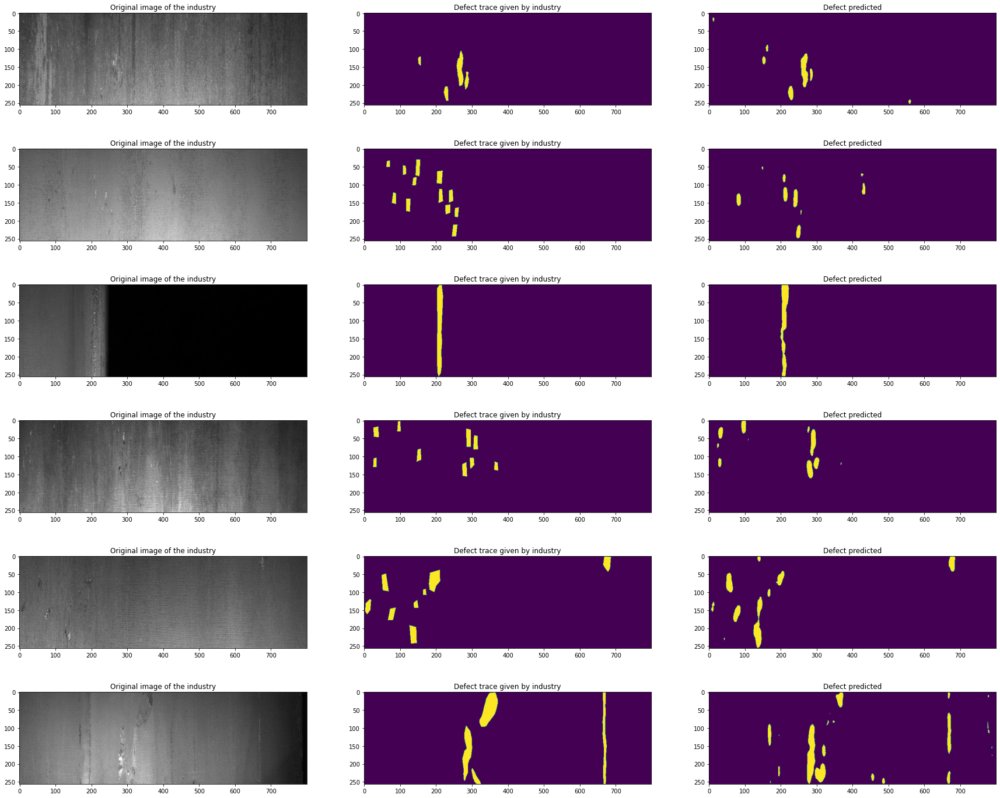

In [ ]:
print("                           Train Dataset Images (1)")
Image_Visualizaton(6,3,predictions_tensor,test_dataset)

# Subclass Train class2

In [ ]:
model2  = Training(True,40)
model2.train()

In [ ]:
%load_ext tensorboard
%tensorboard --logdir '/content/gdrive/My Drive/CaseStudy3/GradientTapeModels/SegmentationLogs/Class2_log_001LR'

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6007 (pid 7502), started 0:09:06 ago. (Use '!kill 7502' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
training  = Training(True,1)
_,_,model = training.ReloadingModel()
predictions_tensor = tf.Variable(tf.zeros((len(X_test),256,800)))
dicescore_tensor = tf.Variable(tf.zeros((len(X_test))))
with tf.device('gpu:0'):
  for batch,(batch_x, batch_y) in enumerate(test_dataset): 
      predictions = model(batch_x)
      predictions = tf.reduce_mean(predictions,0)
      predictions = predictions[:,:,:,0]
      predictions = tf.cast(predictions, dtype=tf.float32)
      predictions = np.where(predictions[0,:,:] > 0.5, 1, 0)
      predictions_tensor[batch].assign(predictions)
      dicescore_tensor[batch].assign(DiceCoef(batch_y,predictions))
print(f"Dice Score for class 2 is : , {tf.reduce_sum(dicescore_tensor)/(batch+1)}")      

Latest checkpoint restored!!
Dice Score for class 2 is : , 0.5207008719444275


In [ ]:
saved_model = '/content/gdrive/My Drive/CaseStudy3/inference/Class2'
tf.saved_model.save(model, saved_model)

                           Train Dataset Images (2)


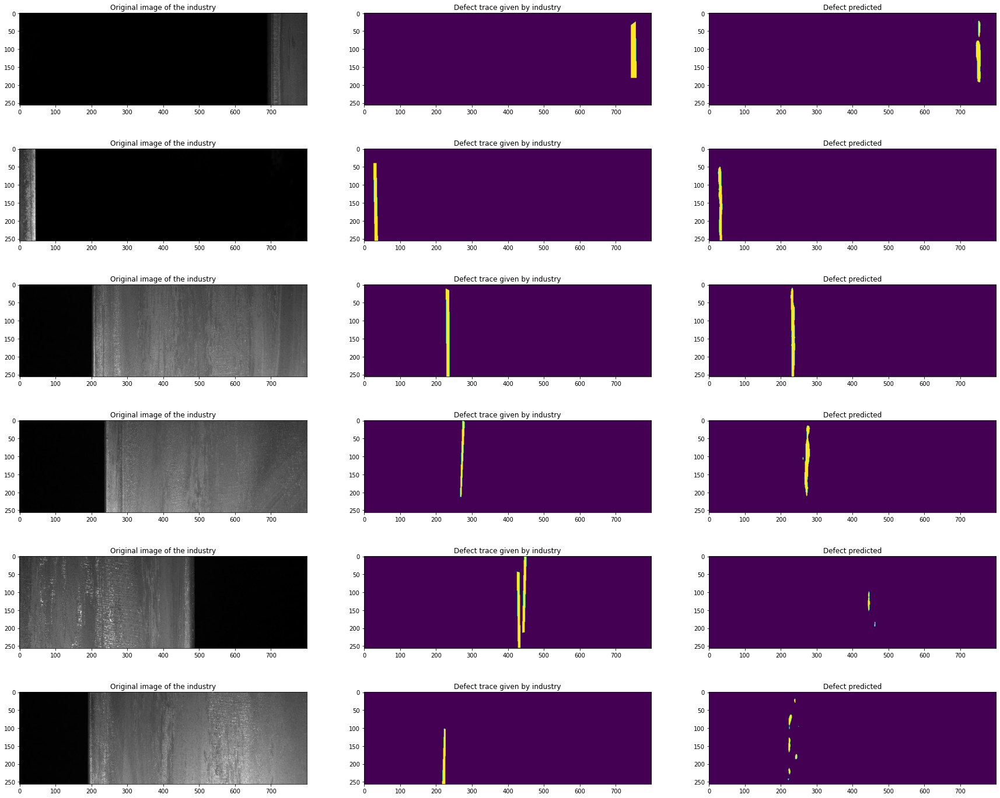

In [ ]:
print("                           Train Dataset Images (2)")
Image_Visualizaton(6,3,predictions_tensor,test_dataset)

# Subclass Train class3

In [ ]:
training  = Training(False,25)
training.train()

In [ ]:
%load_ext tensorboard
%tensorboard --logdir '/content/gdrive/My Drive/CaseStudy3/GradientTapeModels/SegmentationLogs/Class3_log'

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

In [ ]:
training  = Training(True,1)
_,_,model = training.ReloadingModel()
predictions_tensor = tf.Variable(tf.zeros((len(X_test),256,800)))
dicescore_tensor = tf.Variable(tf.zeros((len(X_test))))
with tf.device('gpu:0'):
  for batch,(batch_x, batch_y) in enumerate(test_dataset): 
      predictions = model(batch_x)
      predictions = tf.reduce_mean(predictions,0)
      predictions = predictions[:,:,:,0]
      predictions = tf.cast(predictions, dtype=tf.float32)
      predictions = np.where(predictions[0,:,:] > 0.5, 1, 0)
      predictions_tensor[batch].assign(predictions)
      dicescore_tensor[batch].assign(DiceCoef(batch_y,predictions))
print(f"Dice Score for class 3 is : , {tf.reduce_sum(dicescore_tensor)/(batch+1)}")   


Latest checkpoint restored!!
Dice Score for class 3 is : , 0.6770622134208679


In [ ]:
saved_model = '/content/gdrive/My Drive/CaseStudy3/inference/Class3'
tf.saved_model.save(model, saved_model)

                           Test Dataset Images (3)


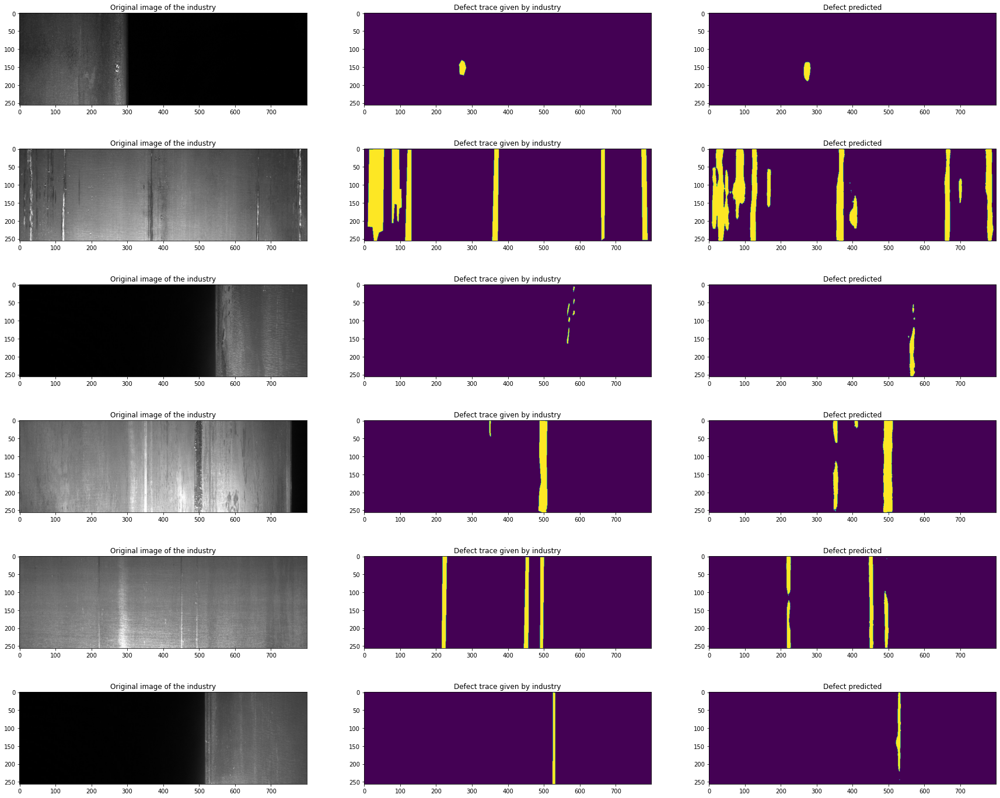

In [ ]:
print("                           Test Dataset Images (3)")
Image_Visualizaton(6,3,predictions_tensor,test_dataset)

# Subclass Train class4

In [ ]:
training  = Training(False,25)
training.train()

In [ ]:
%load_ext tensorboard
%tensorboard --logdir '/content/gdrive/My Drive/CaseStudy3/GradientTapeModels/SegmentationLogs/Class4_log'

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

In [ ]:
training  = Training(True,1)
_,_,model = training.ReloadingModel()

predictions_tensor = tf.Variable(tf.zeros((len(X_test),256,800)))
dicescore_tensor = tf.Variable(tf.zeros((len(X_test))))
with tf.device('gpu:0'):
  for batch,(batch_x, batch_y) in enumerate(test_dataset): 
      predictions = model(batch_x)
      # predictions = tf.reduce_mean(predictions,0)
      predictions = predictions[-2][:,:,:,0]
      predictions = tf.cast(predictions, dtype=tf.float32)
      predictions = np.where(predictions[0,:,:] > 0.5, 1, 0)
      predictions_tensor[batch].assign(predictions)
      dicescore_tensor[batch].assign(DiceCoef(batch_y,predictions))
print(f"Dice Score for class 2 is :  {tf.reduce_sum(dicescore_tensor)/(batch+1)}")        

Dice Score for class 2 is :  0.7339463829994202


                           Train Dataset Images (4)


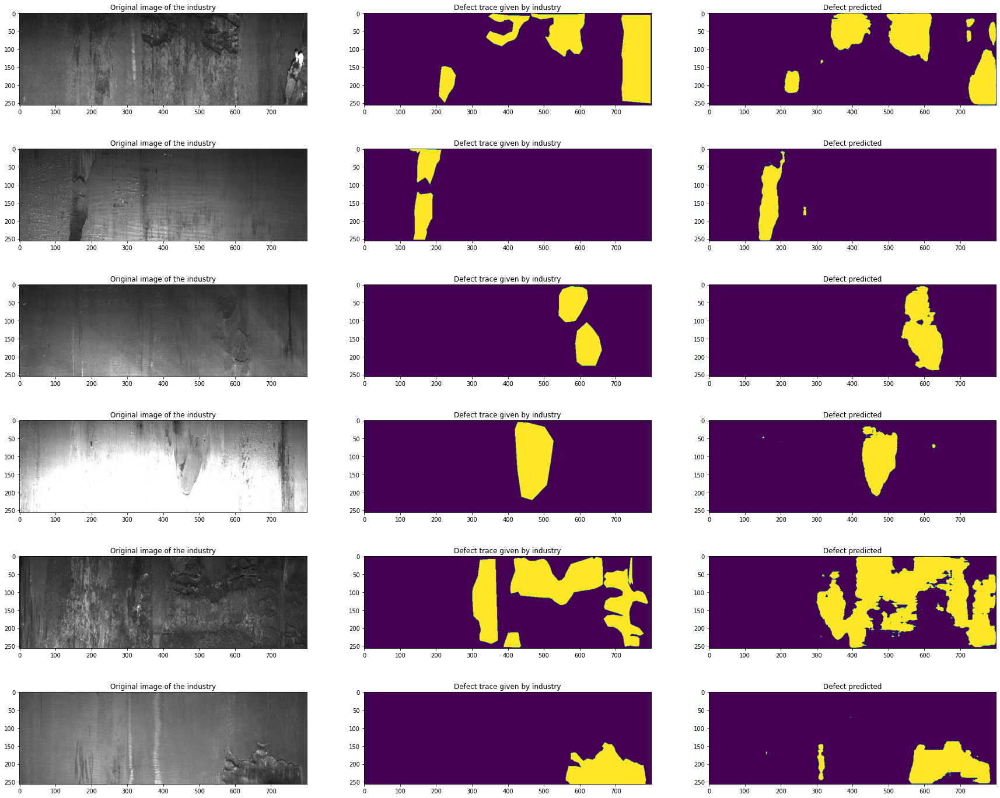

In [ ]:
print("                           Train Dataset Images (4)")
Image_Visualizaton(6,3,predictions_tensor,test_dataset)

# Subclass Train Multiclass Class

In [ ]:
training  = Training(False,20)
training.train()

Model loaded from scratch!!
Epoch 1/20

Metrics increased from -1.0 to 0.07283872365951538

Saving checkpoint for epoch 2 at /content/gdrive/My Drive/CaseStudy3/GradientTapeModels/SegmentationModels/training_checkpoints1/ckpt-1
Epoch 2/20

Metrics increased from 0.07283872365951538 to 0.09612495452165604

Saving checkpoint for epoch 3 at /content/gdrive/My Drive/CaseStudy3/GradientTapeModels/SegmentationModels/training_checkpoints1/ckpt-2
Epoch 3/20

Metrics increased from 0.09612495452165604 to 0.2708292603492737

Saving checkpoint for epoch 4 at /content/gdrive/My Drive/CaseStudy3/GradientTapeModels/SegmentationModels/training_checkpoints1/ckpt-3
Epoch 4/20

Metrics increased from 0.2708292603492737 to 0.36505019664764404

Saving checkpoint for epoch 5 at /content/gdrive/My Drive/CaseStudy3/GradientTapeModels/SegmentationModels/training_checkpoints1/ckpt-4
Epoch 5/20

Metrics increased from 0.36505019664764404 to 0.4152282774448395

Saving checkpoint for epoch 6 at /content/gdrive/My

In [ ]:
%load_ext tensorboard
%tensorboard --logdir '/content/gdrive/My Drive/CaseStudy3/GradientTapeModels/SegmentationLogs/check6'

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

# Summary



1.  `I tried both weighted multiclass segmentation and 4 individual segmentation`.
2.   `Individual segmentation  dice score class1,class2,class3,class4 : .73,.57,.67,.60 `
3.   `Weighted multiclass segmentation  dice score  : .65 `
4. `I tried with both models at the time of inference and individual segmentation gave me good results.`
